# Project 2 Board game object tracking
* Krzysztof Weber 151934
* Adam Mielniczuk 151928

* all the source code available at https://github.com/krzysztof-m-w/object-tracking
* recordings available at https://drive.google.com/drive/folders/1_1WPRSDI7enadn27khBMQWyzfWyivLuz?hl=pl-pl

The game chosen by us is chess.
The aim of the first milestone was to detect two game pieces. We were able to detect a chessboard and all the pieces. There are still some difficulties with the object detection but we are still working on it.

All functions used in latter examples are defined in utils.py file. It is to make the report more readable.

In [2]:
from utils import *

## Data preparation.

We have prepared 9 recordings of 9 chess games. The are in three categories:
### 1. Easy 
The camera remains static during the whole recording. The scenes is well lighted. Most of the figures are clearly distinguishable from the background. The exception may be some black pieces standing on the black squares. When moves are made large portions of the board are covered by hand.

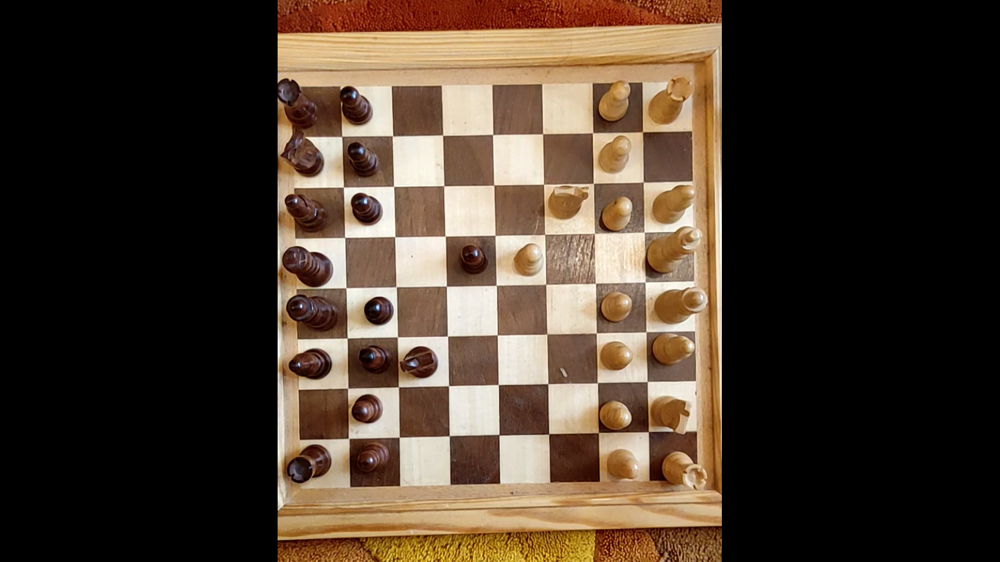

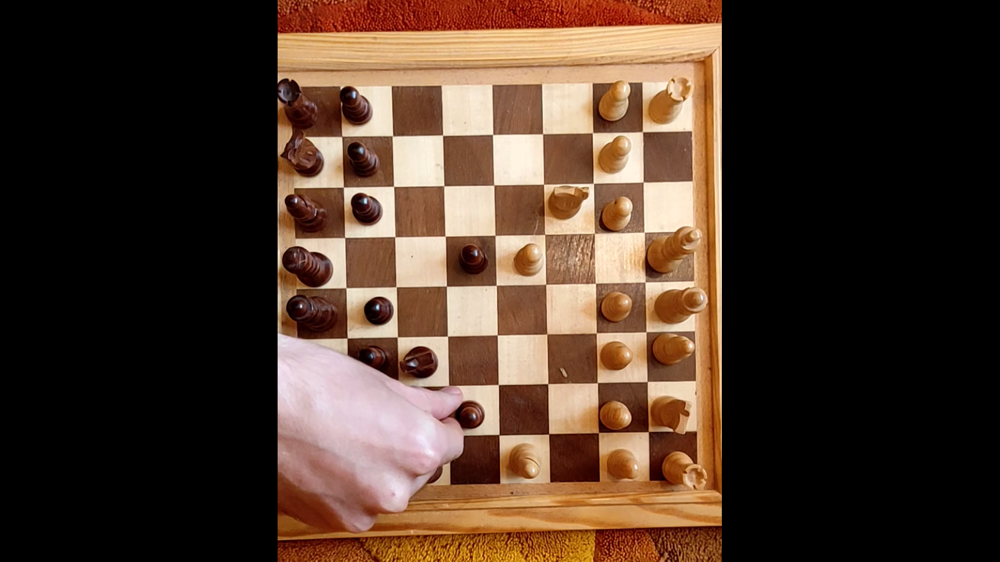

### 2. Medium 
The camera is still static but the lighting is a lot more dull. Many pieces are hard to distinguish from the background. Hand covering is the same as for the easy set.

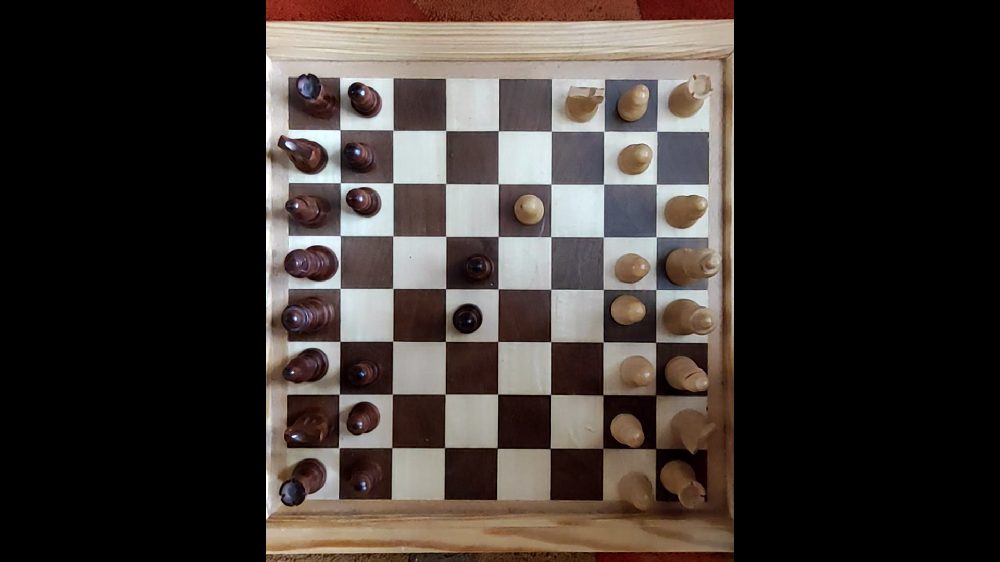

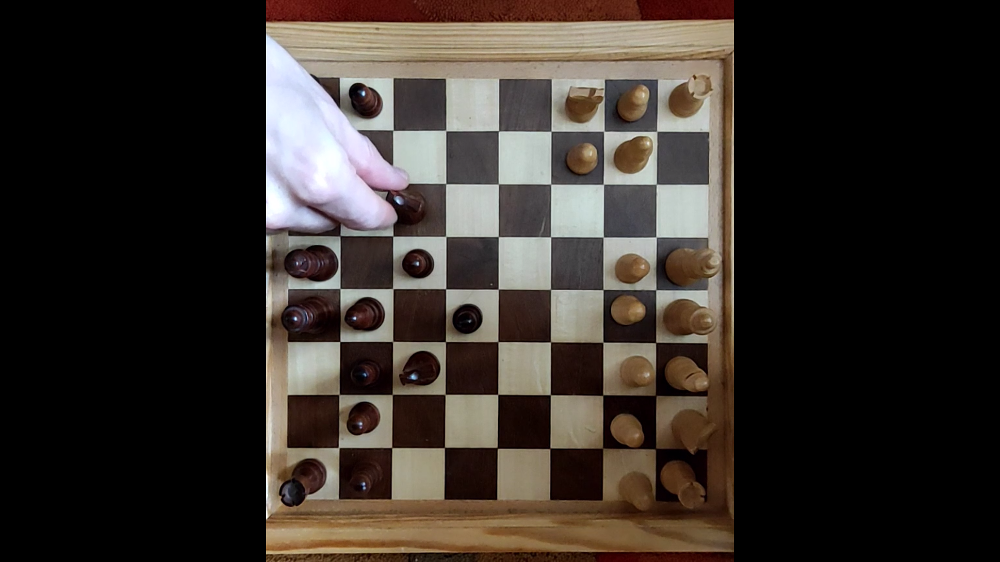

### 3. Hard 
The camera is held in the hand making the recording very shaky. The lighting is dull and changing in time. Hand still covers large portions of the board in during each move.

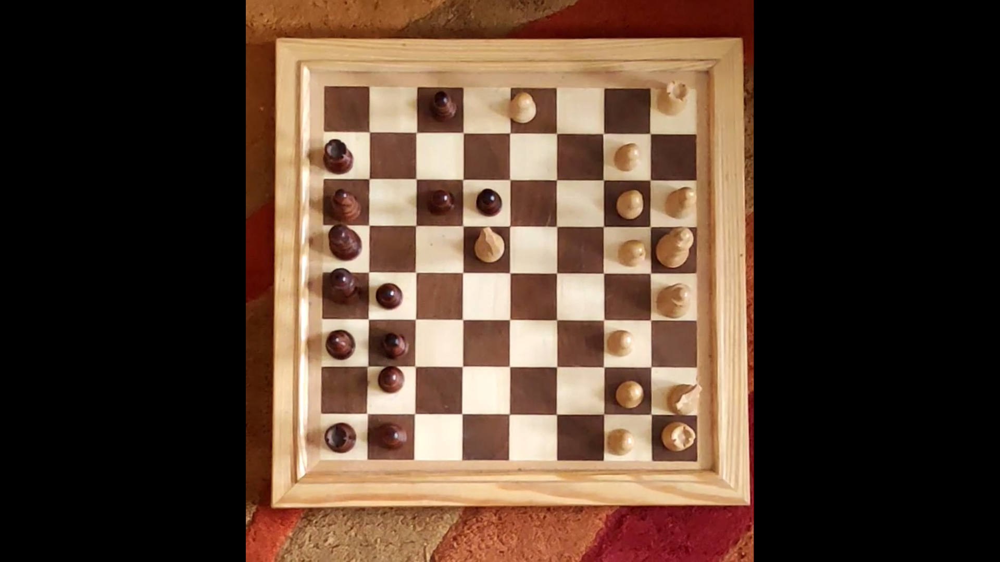

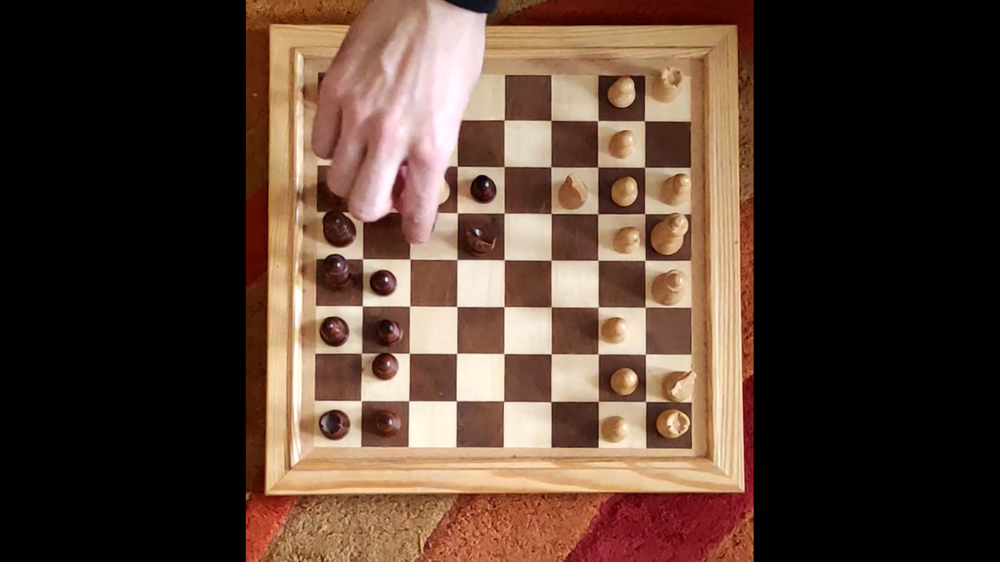

## Board detection

In [3]:
chess = video_from_path('recordings\Easy1.mp4')

Video loaded
912 720
30.00030000300003


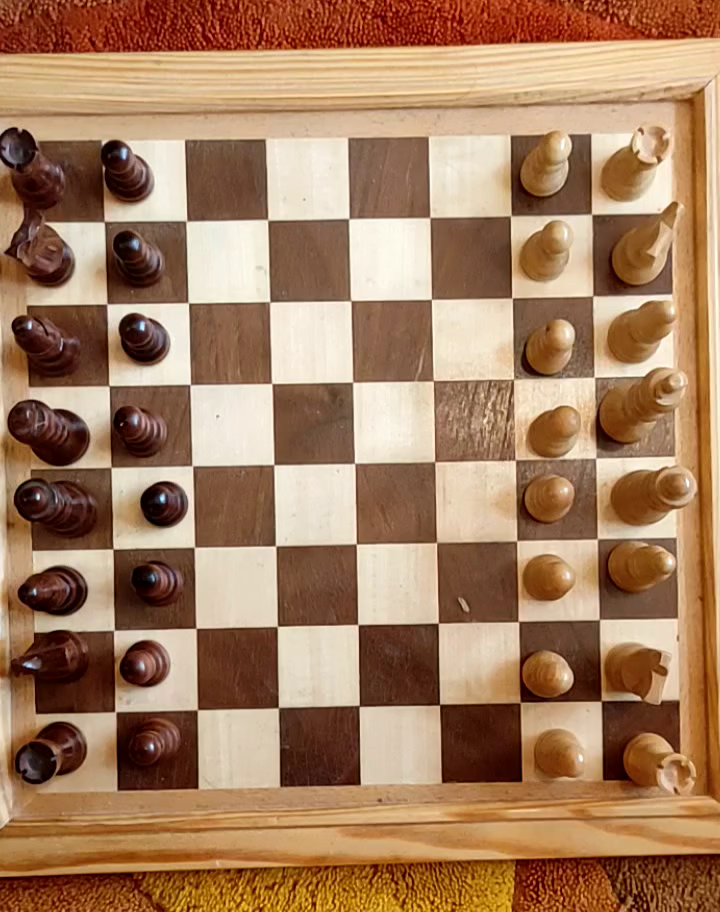

In [4]:
frame = get_first_frame(chess)

Finding lines is made using HoughLinesP function along with canny edge detection. The lines are then represented with slopes and shifts defined in the form of y = ax + b and x = ay + b due to the fact that many lines are perfectly or almost perfectly vertical or horizontal.

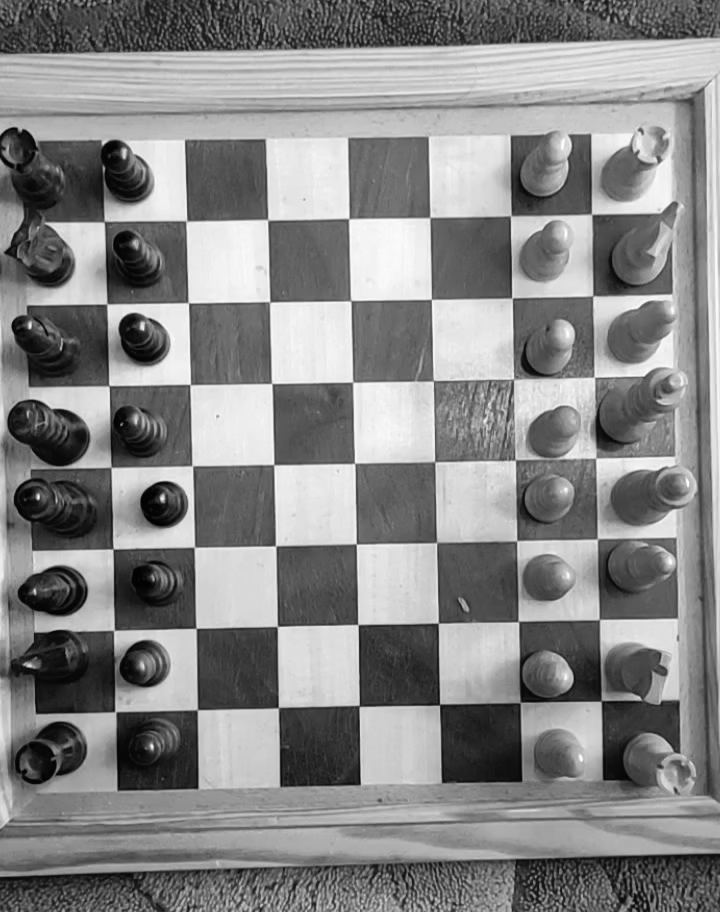

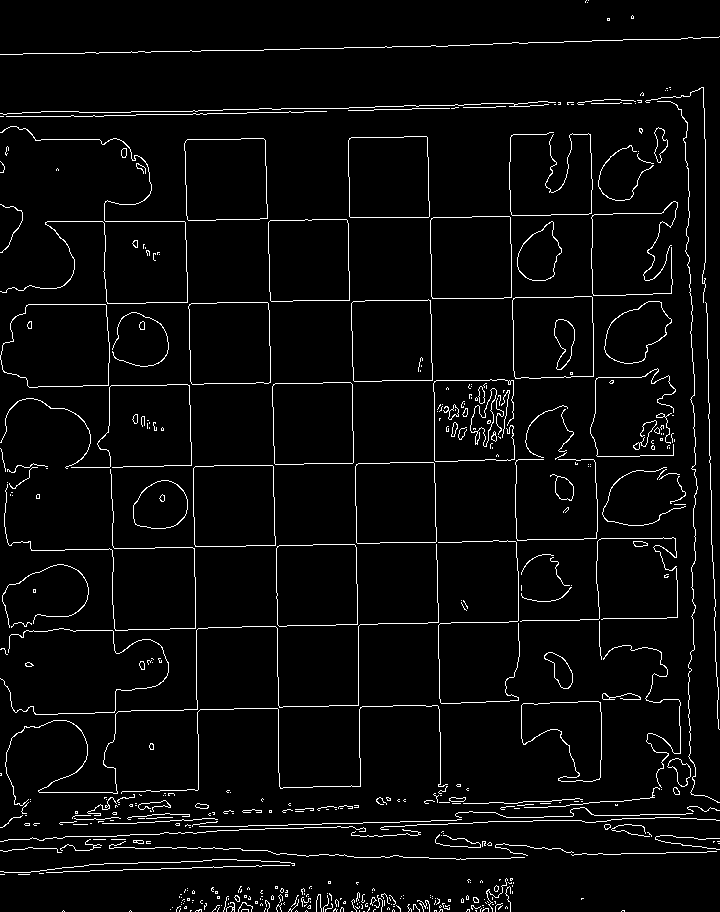

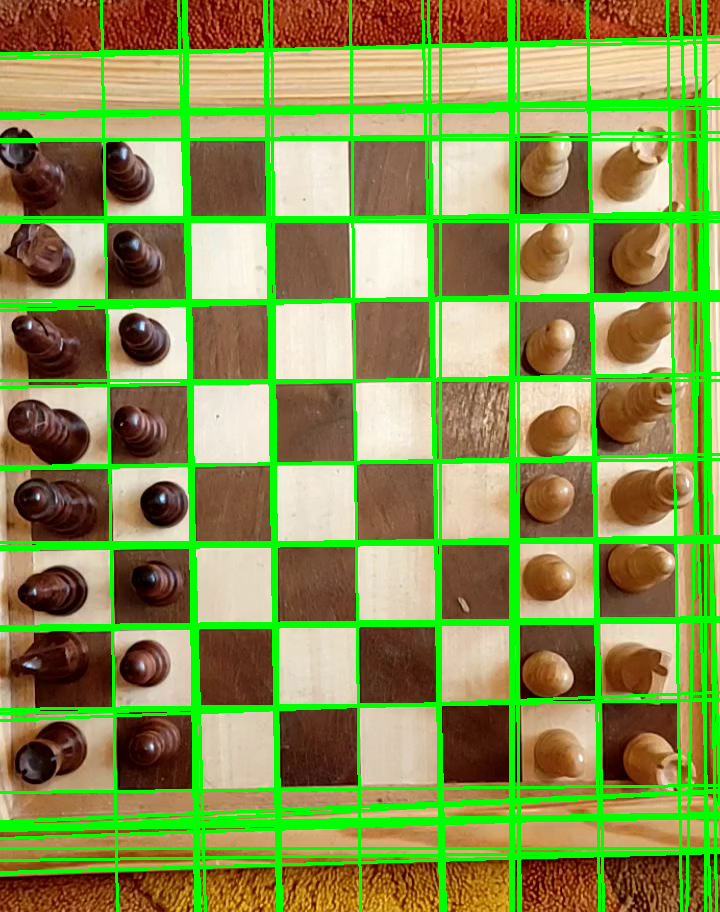

In [5]:
lines = find_lines(frame)

Here we are looking for the squares on the chessboard. It is done by using the findContours function from cv2 on the threshold image. The we then calculate the convex hull of the contour to get rid of any distortions. If the contour has 4 edges and the lengths of the opposite edges are similar, then the contour is considered a chessboard square. Information about the chessboard squares: their width, height and the slopes of the edges will be used in chessboard grid detection.

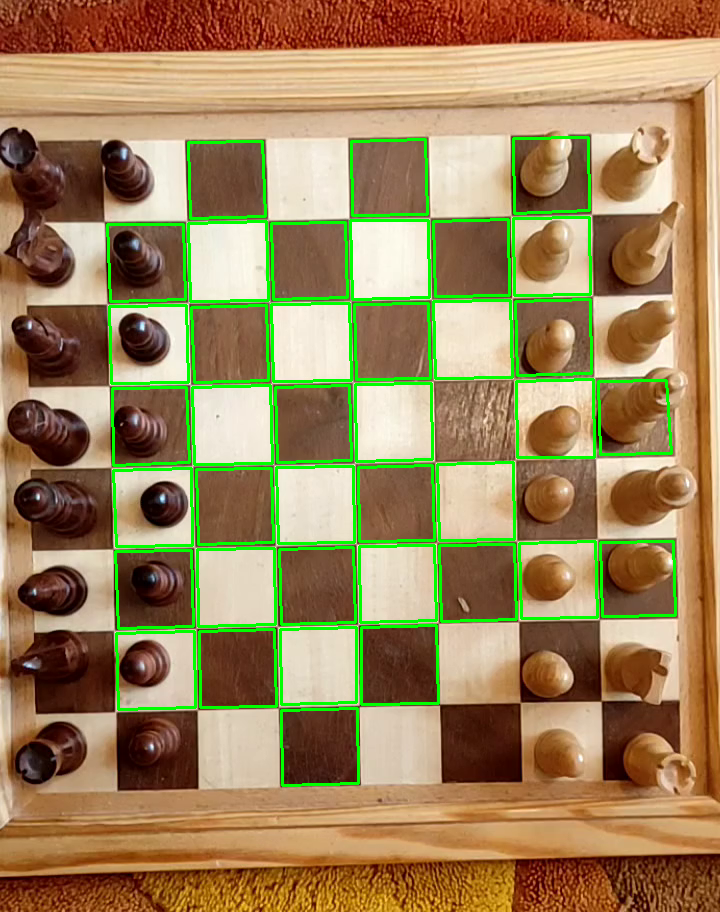

In [6]:
gap_lengths, new_lines = find_square_parameters(frame)
lines.extend(new_lines)

Based on the square parameters we try to find a subset of 18 lines representing a grid. Lines should be in the similar distances from each other as the length of the square edges and their slopes should be similar to square slopes.

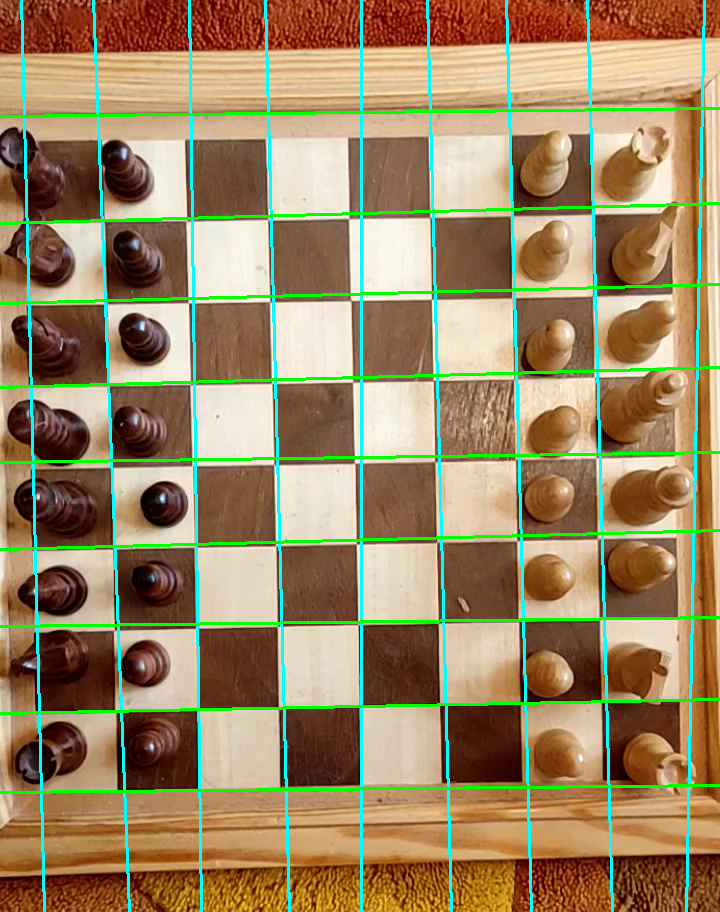

In [7]:
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.1)

Finally based on the chosen lines and their intersections we can define a chessboard grid with each cell being its own contour. 

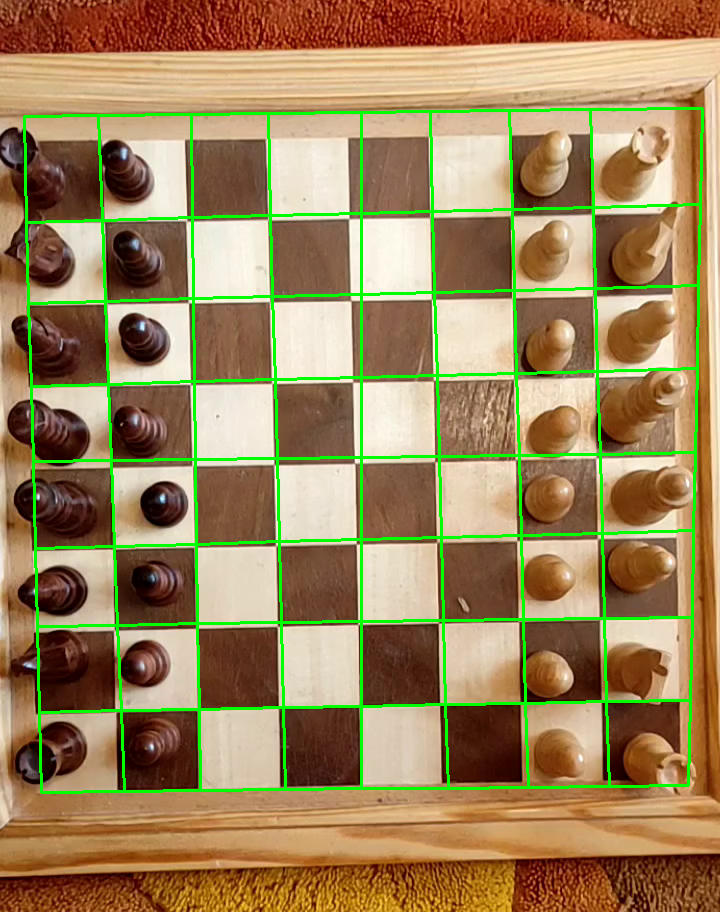

In [8]:
square_contours = find_square_contours(frame, chessboard_lines)

## Chessboard tracking

As on the hard videos the image is shaky the position of the chessboard must be tracked. To achieve this we find a bounding box by identifying bottom-left and top-right corners of the chessboard grid. The chessboard is then tracked by the MIL tracker. The grid is adjusted appropriately to the tracked bounding box.

## Processing steps for each subset

### Easy

#### Easy1

Video loaded
912 720
30.00030000300003


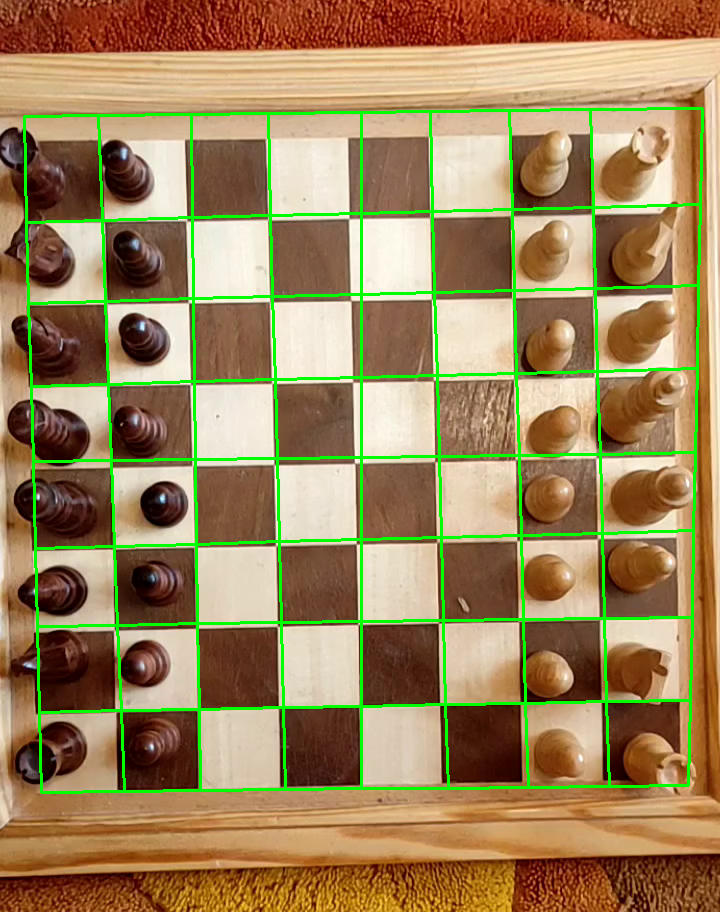

In [11]:
chess = video_from_path('recordings\Easy1.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.1, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [4]:
write_and_detect_chessboard(chess, square_contours, 'Easy1')

#### Easy2

Video loaded
920 720
30.00030000300003


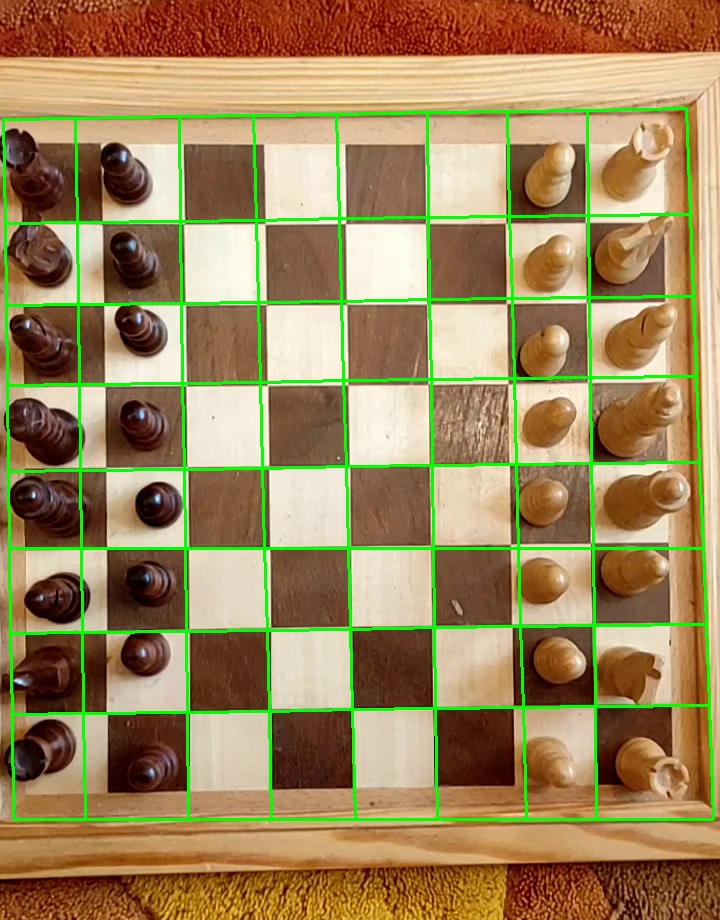

In [12]:
chess = video_from_path('recordings\Easy2.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.18, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [6]:
write_and_detect_chessboard(chess, square_contours, 'Easy2')

#### Easy3

Video loaded
876 720
30.00030000300003


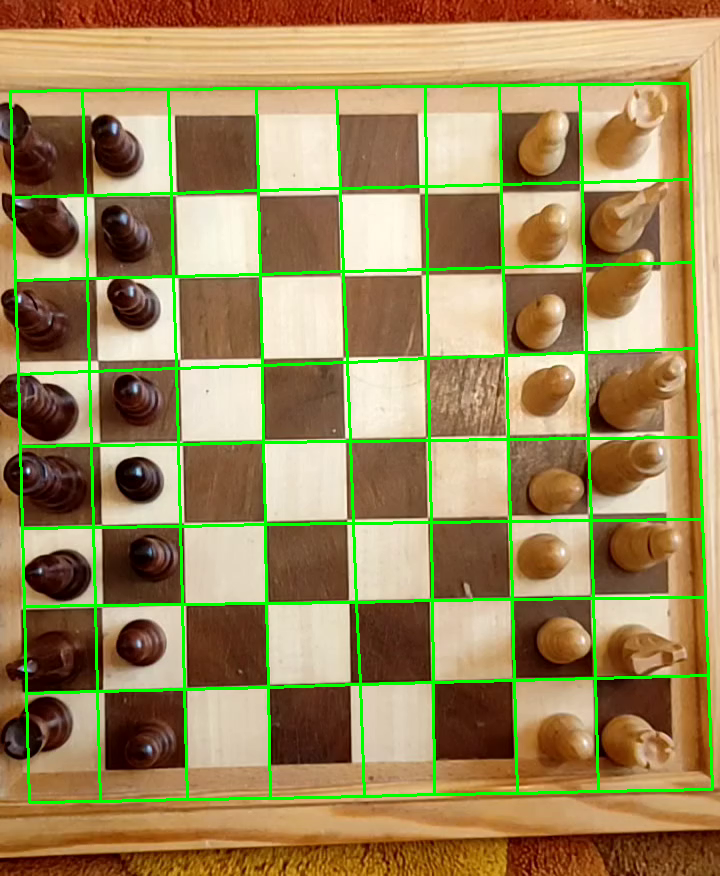

In [13]:
chess = video_from_path('recordings\Easy3.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
chessboard_lines = [chessboard_lines[0], chessboard_lines[2]]
square_contours = find_square_contours(frame, chessboard_lines)

In [8]:
write_and_detect_chessboard(chess, square_contours, 'Easy3')

### Medium

#### Medium 1

Video loaded
866 720
30.00030000300003


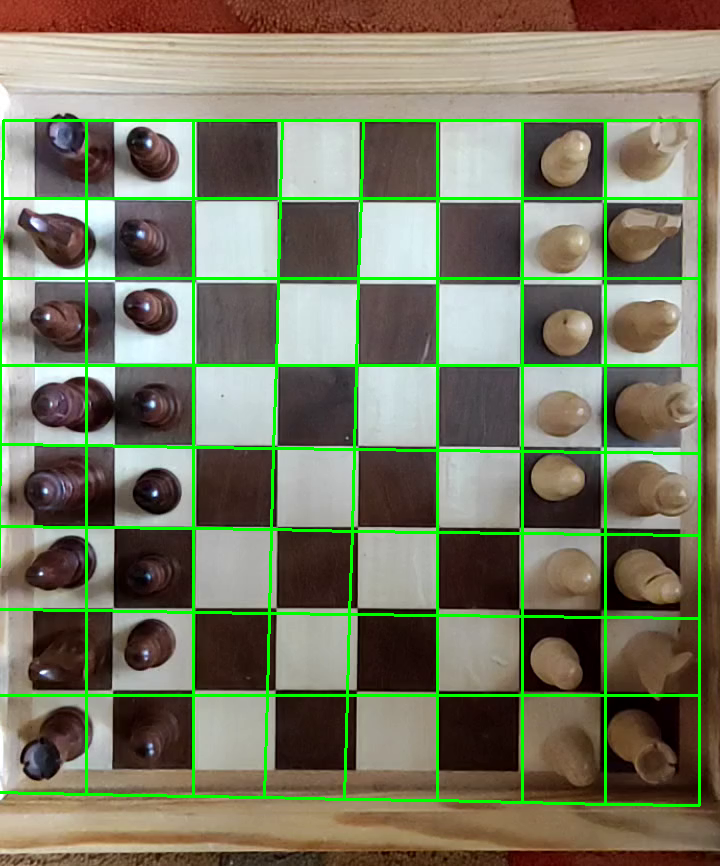

In [14]:
chess = video_from_path('recordings\Medium1.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [10]:
write_and_detect_chessboard(chess, square_contours, 'Medium1')

#### Medium 2

Video loaded
884 720
30.00030000300003


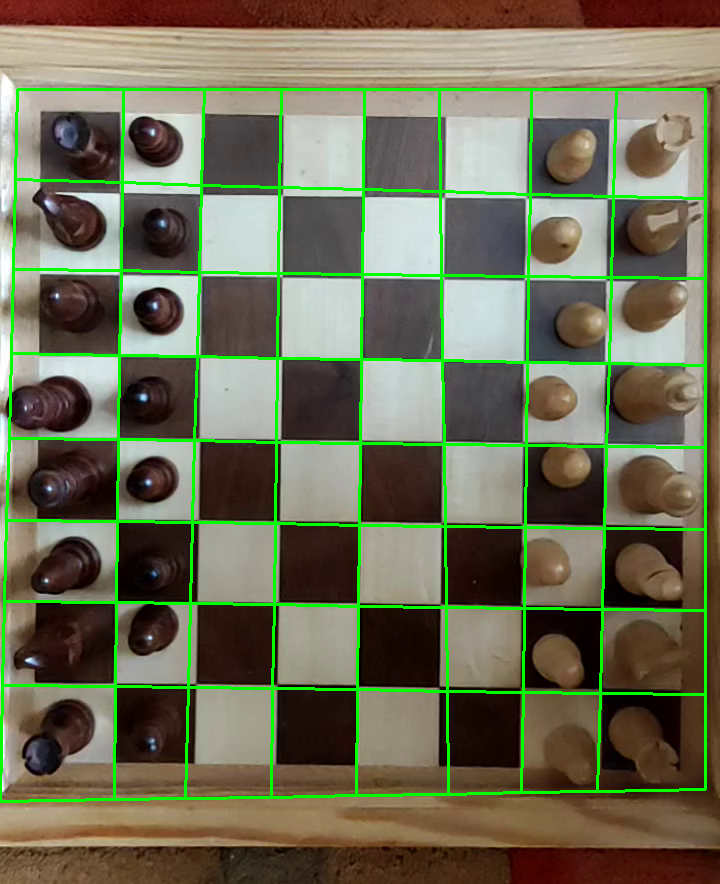

In [15]:
chess = video_from_path('recordings\Medium2.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [12]:
write_and_detect_chessboard(chess, square_contours, 'Medium2')

#### Medium 3

Video loaded
876 720
30.00030000300003


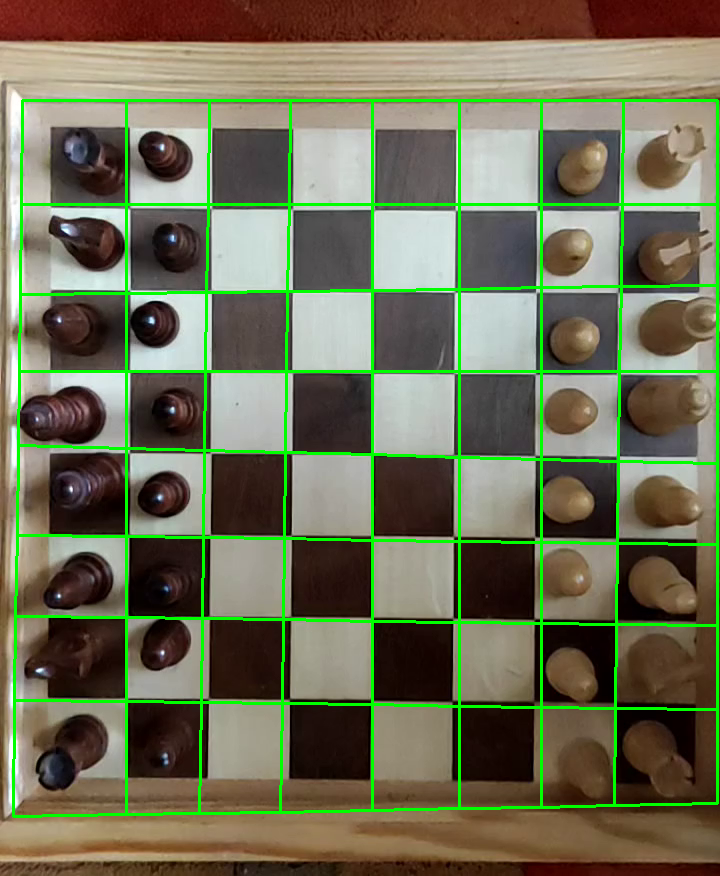

In [16]:
chess = video_from_path('recordings\Medium3.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [14]:
write_and_detect_chessboard(chess, square_contours, 'Medium2')

### Hard

#### Hard1

Video loaded
816 720
30.00030000300003


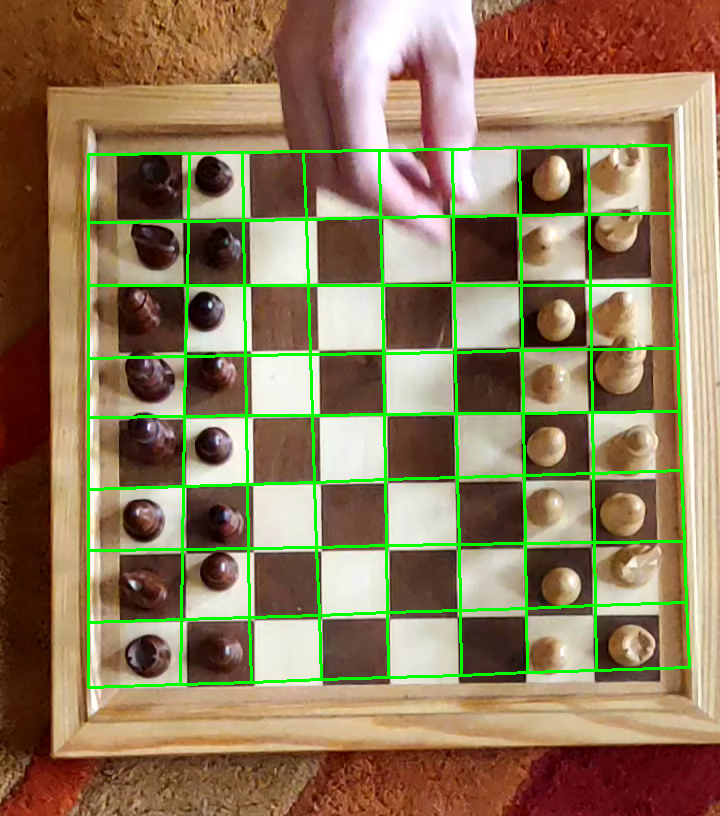

In [17]:
chess = video_from_path('recordings\Hard1.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.2)
chessboard_lines[1][0][0] = 418
square_contours = find_square_contours(frame, chessboard_lines)

In [16]:
write_and_detect_chessboard(chess, square_contours, 'Hard1')

#### Hard2

In [17]:
from utils import *

Video loaded
798 720
30.00030000300003


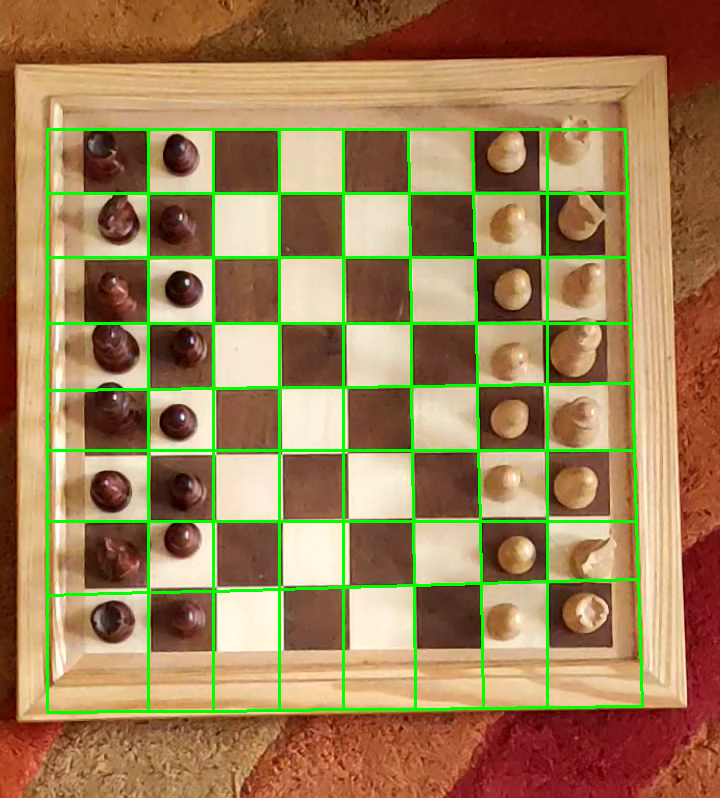

In [18]:
chess = video_from_path('recordings\Hard2.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
gap_lengths = {1.5538487969884918: 62.00403199585499, 3.1088175091857173: 61.51638903933426}
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.2, if_display=False)
chessboard_lines[1][0][1] = 450
square_contours = find_square_contours(frame, chessboard_lines)

In [19]:
write_and_detect_chessboard(chess, square_contours, 'Hard2')

#### Hard3

Video loaded
720 752
30.00030000300003


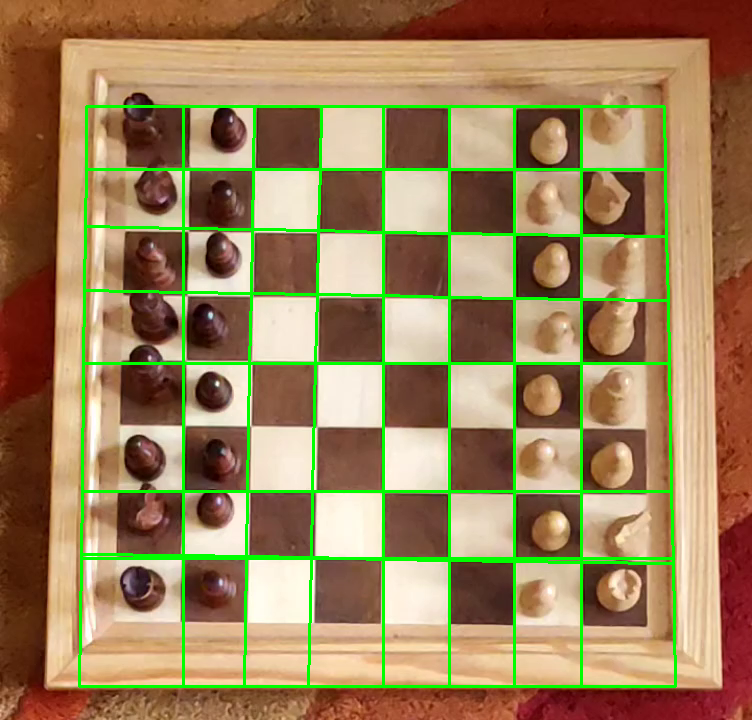

In [20]:
chess = video_from_path('recordings\Hard3.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
print(lines)
gap_lengths = {1.5538487969884918: 62.00403199585499, 0: 61.51638903933426}
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.2, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [21]:
write_and_detect_chessboard(chess, square_contours, 'Hard3')

## Hand detection

During the process of solving the problem we discovered that the separation of foreground and background in the video can be a good way of distinguishing between the frames with the hand present on it and those without it. Most of the scene is treated as a background and the hand, which appears and disappears from the scene as well as the figures moved by it are treated as the foreground. Discovering the frames containing the hand can be then simply based on the average brightness of the foreground. If the average is above some certain threshold we can assume that there is a hand in the frame. It is an essential information as frames with significant part of the board covered have no use in estimation the game status.

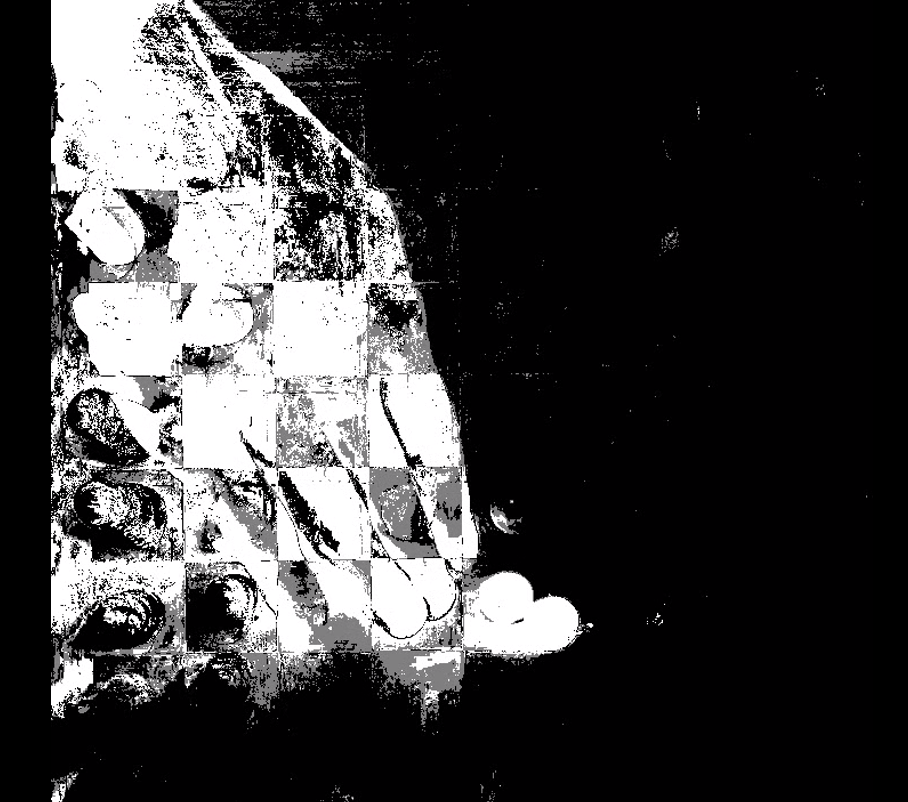

## Figure detection

We have tested many different methods in order to find the figures locations. Finding circles using HoughCircles proved to be the most effective. The exact relation between the position of each piece and the board is captured based on pointPolygonTest which calculates the distance of the circle center from the edge of the contour. We also take into account the circles which are outside of some contours as due to the perspective some parts of the peaces appear to be shifted from their actual positions. The circle detection is not perfect. Often it captures some noise or the hand moving the pieces across and for some figures it has problem to detect them because the edges are not so intense or the circle shape is partially covered by the rest of the figure. Despite of those problems the game can still be tracked by using additional information about it current state.

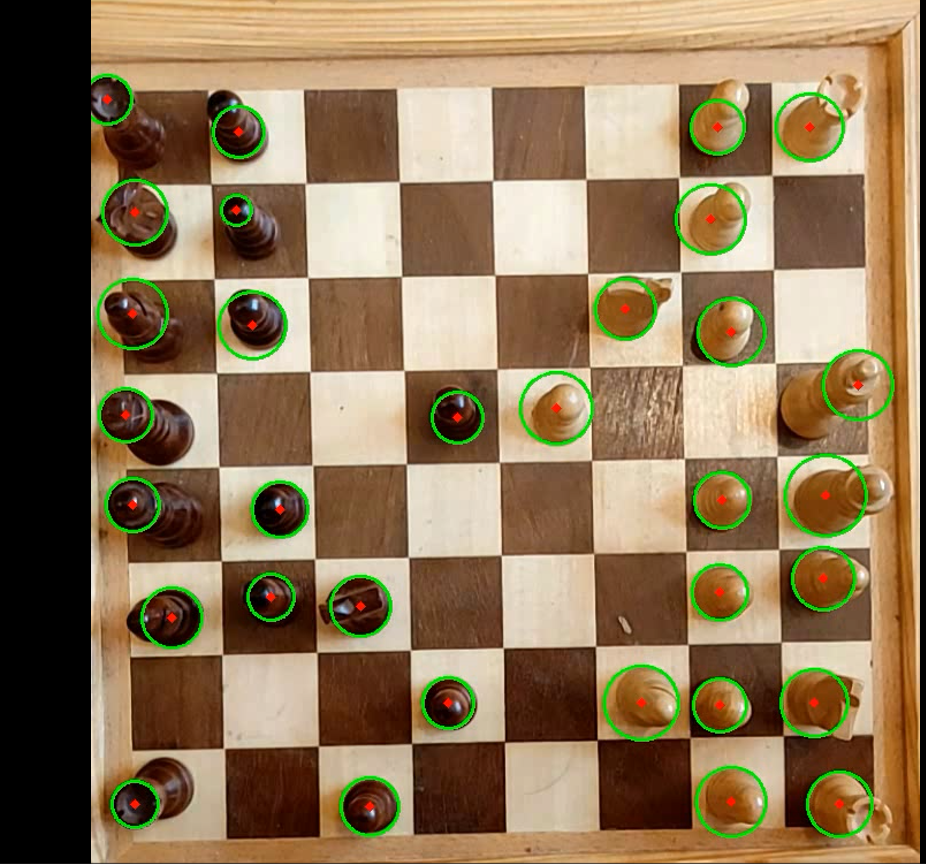
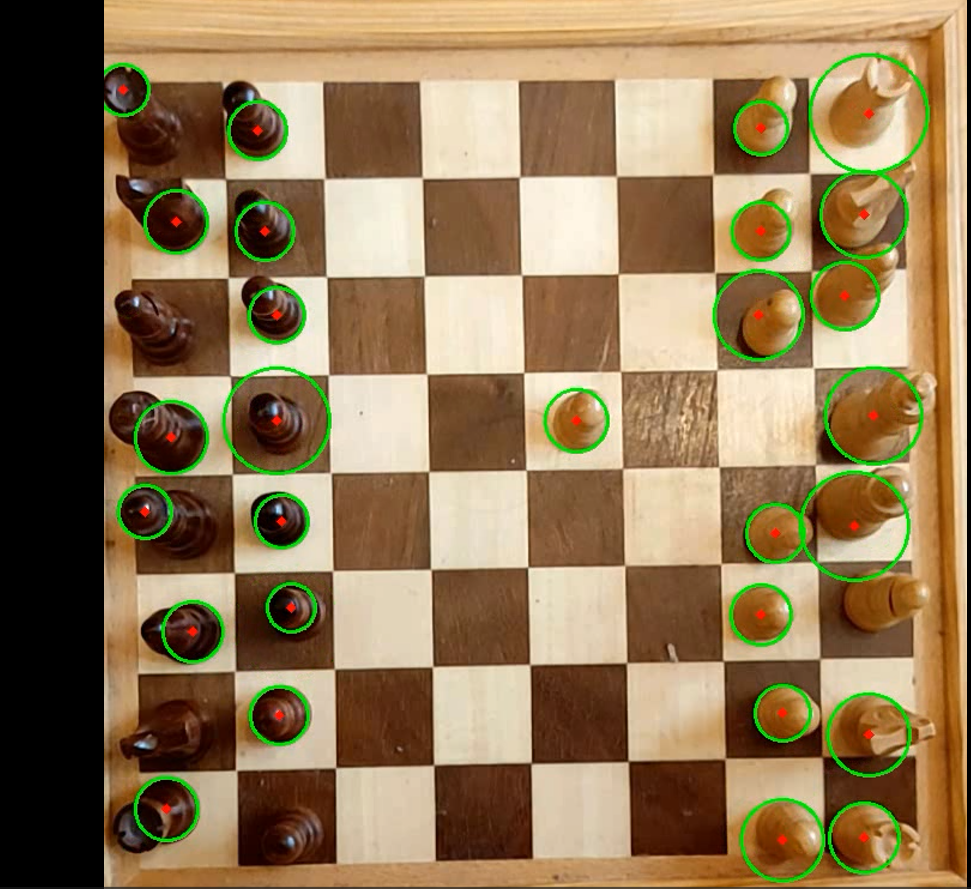
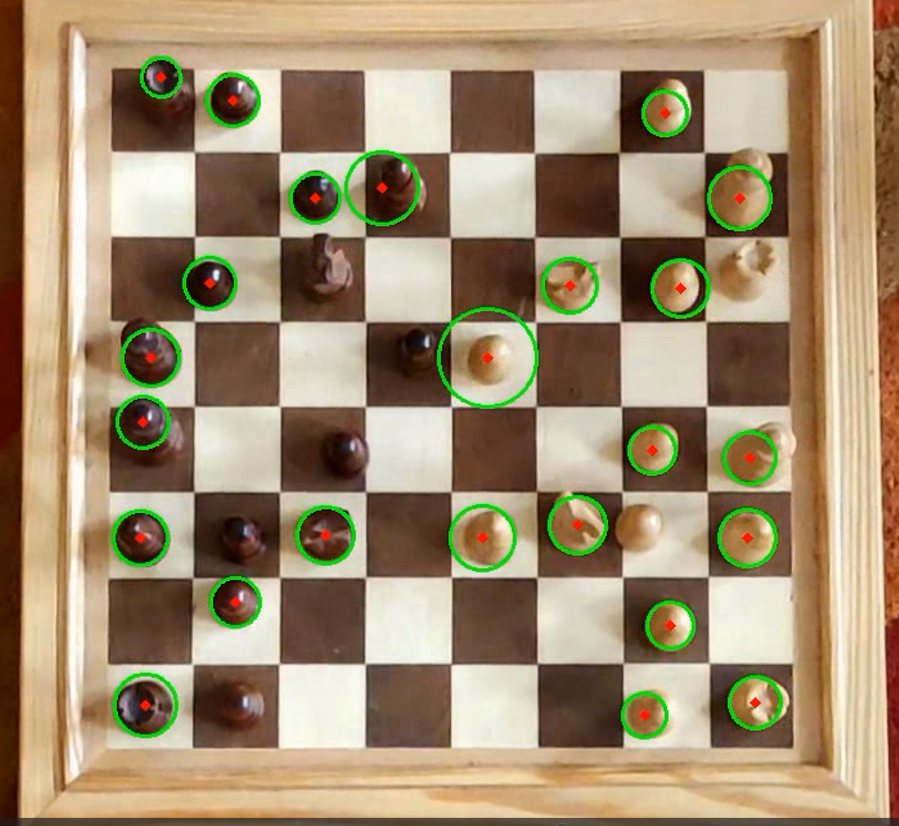

## Game tracking

Game tracking is made with the help of the python chess library. The library enables us to track the real game state and to check which moves are legal in which position. Given the information about the position of each figure with respect to the chessboard we can detect the changes, for example that the figure disappeared from one location and a appeared in the other. However this is rather difficult as the circle detection is nosiy, and the detection very often confuses the hand for a piece. From those changes we can construct the list of possible starting and ending positions. From those two sets we can construct possible moves example: a figure disappeared from the position a8 and a figure appeared on the position b8 we can then construct a move a8b8 and check it with the current game state, whether it is legal or not. 

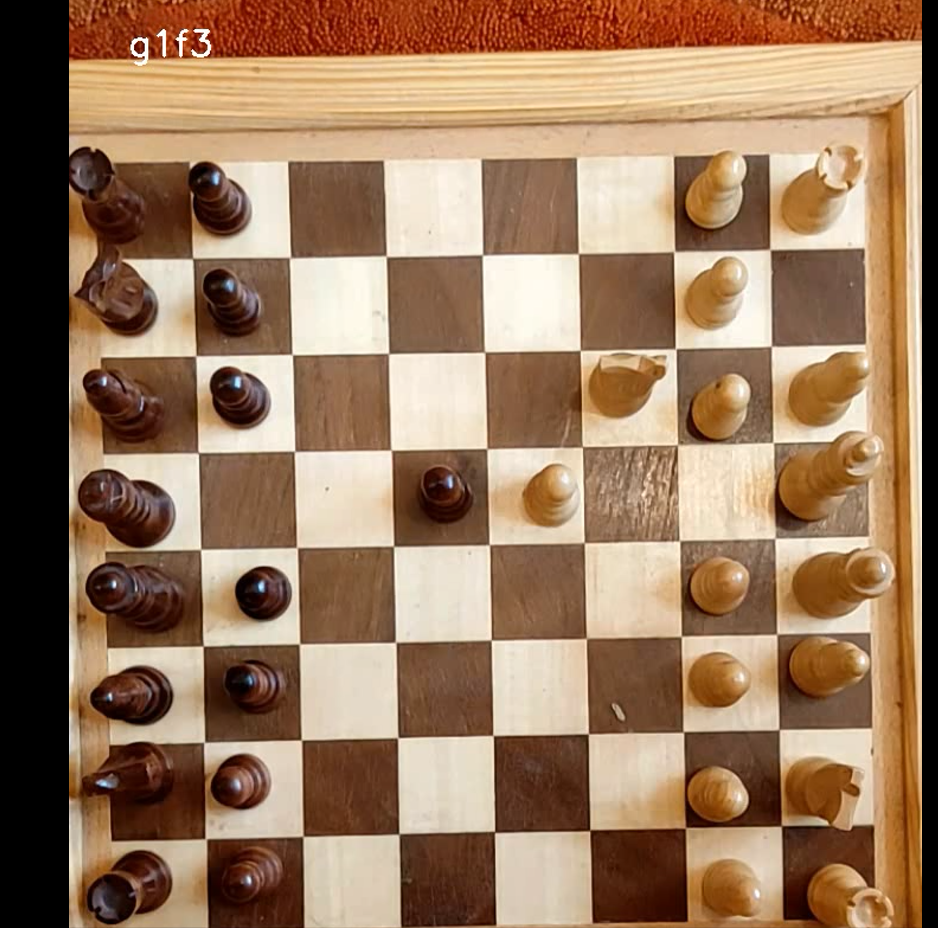

In order to try to fix those issues with tracking the figures and gamestate, we tried many different apporaches to the detection of game state. First we tried to cut out the portions of the video where hand is visible and only use those parts. This however proved unsuccesfull, as sometimes many moves were made without the hand leaving. We also tried to average the circles over a few frames to combat the noise. The hand getting confused for a piece was a big problem - it would very often cause a detection of a different move, which made even the easy videos quite hard to work with and detect the moves properly. 

We have decided to use the detection algorithm multiple times and then try to average out the results. As can be seen on the plots, the frames where a detection of a move happens form almost perfectly straight vertical lines, so we decided to bin the detections based on the frame number they were found in, and then sort the moves based on the amount of times it appears.

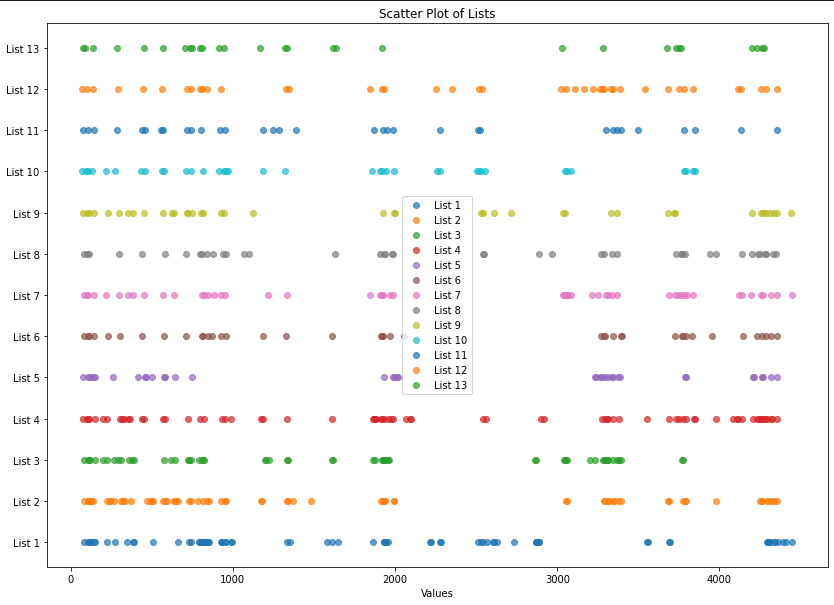 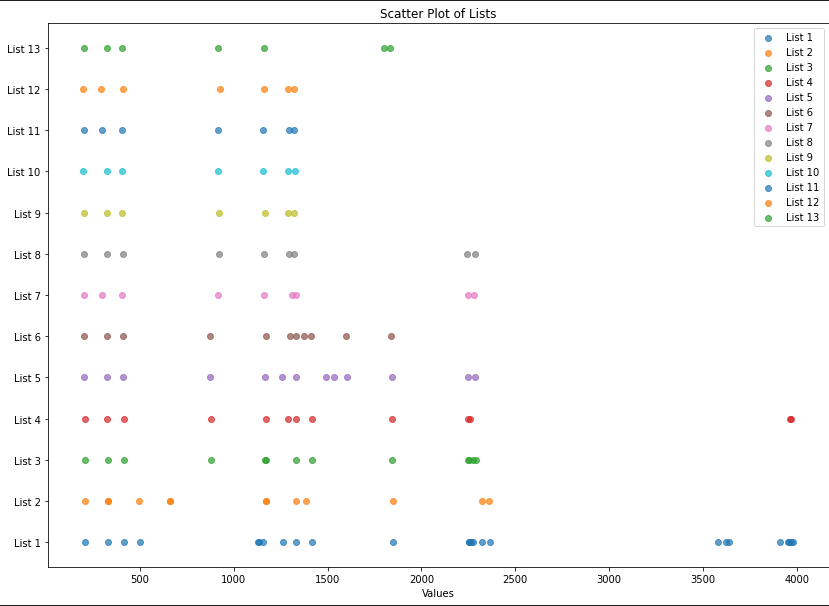

In our final solution we perform 22 detections for both the cut and uncut videos. The binning and averaging is done separetly for both of them and then they are combined into one list. Since for a lot of detection points there were many different found moves, we have decided to diplay up to 4 possible moves that our alogirhtm detected at a time. While this is not an ideal solution it shows more possible moves, one of which can be correct. A detection of captures was also added, however for it to function well the moves would need to be detected perfectly.

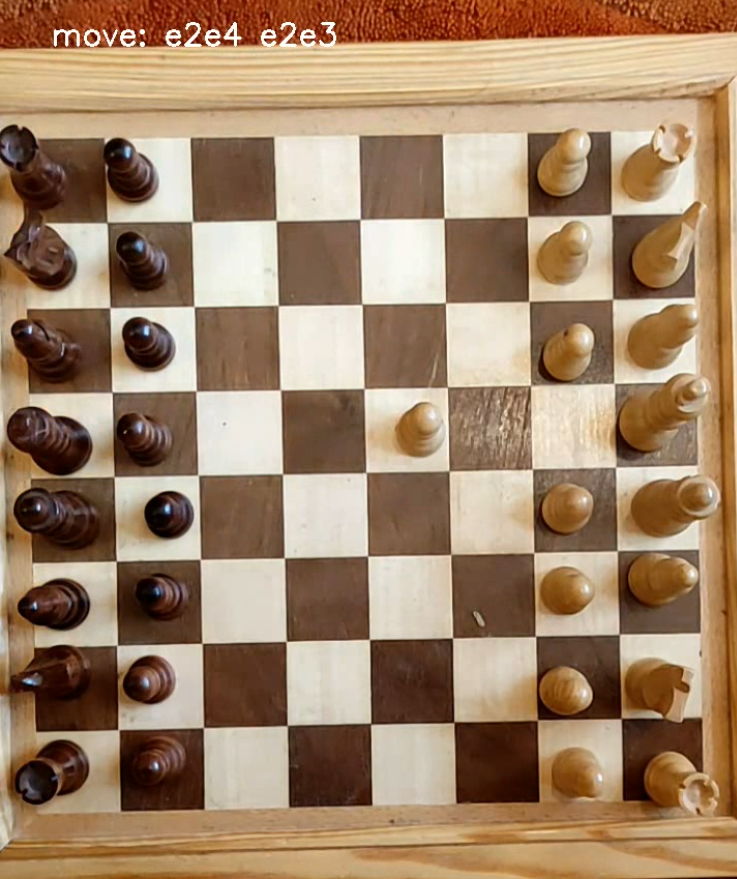 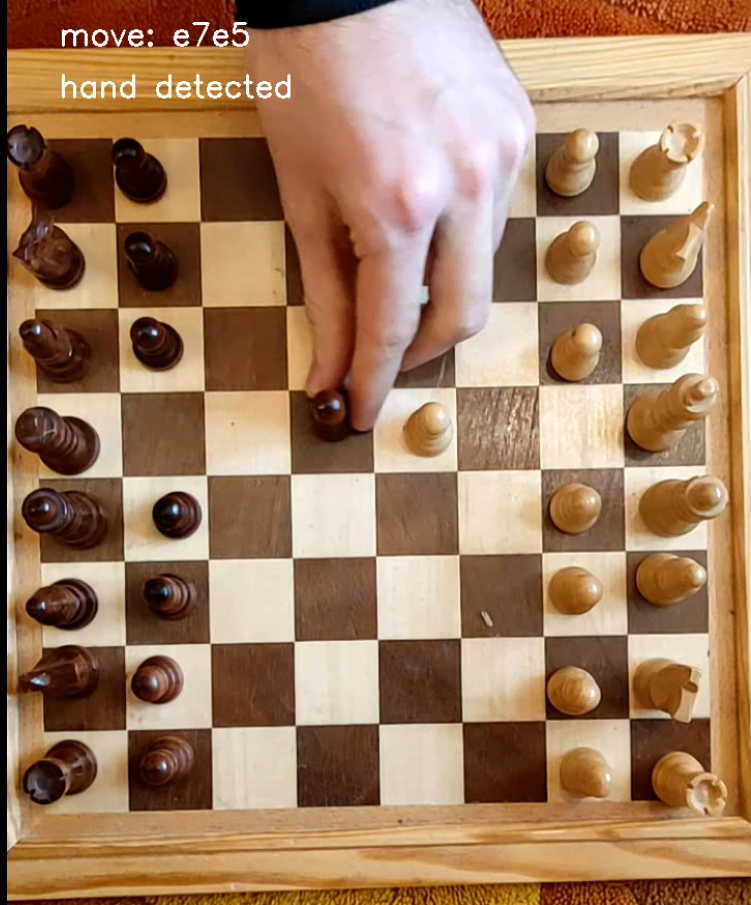

